# OOD Detection using a Convolutional Auto-Encoder (CNN)

This notebook demonstrates the process of training and utilizing a CNN for performing OOD detection on the bollworms image data set. A CNN model was trained on both our `bollworms` and `bollworms-clean` datasets and evaluated for performance on the test data sets of `bollworms` and `bollworms-clean` as well as 2 external data sets.

### General Set Up

#### Package Imports

In [11]:
import os
import glob
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import argparse, imutils, cv2

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import models, layers

from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Layer, Input, Flatten, Dense, Reshape, Dropout, BatchNormalization
from tensorflow.keras.layers import Activation, LeakyReLU, ReLU
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Conv2DTranspose
from tensorflow.keras.callbacks import Callback, EarlyStopping
from tensorflow.keras.losses import MeanSquaredError, MeanAbsoluteError
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.regularizers import L1, L2
import tensorflow.keras.backend as K
from sklearn.model_selection import train_test_split

# pandas configuration options for easier to read print out display
pd.options.display.max_columns = 40
pd.options.display.max_rows = 500     
pd.options.display.max_colwidth = 100
pd.options.display.precision = 3

#### Colab Runtime

In [12]:
print(f"tensorflow version {tf.__version__}")
print(f"keras version {tf.keras.__version__}")
print(f"Eager Execution Enabled: {tf.executing_eagerly()}\n")

devices = tf.config.get_visible_devices()
print(f"All Devices: \n{devices}\n")
print(f"Available GPUs: \n{tf.config.list_logical_devices('GPU')}\n")

AUTOTUNE = tf.data.AUTOTUNE

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

tensorflow version 2.9.2
keras version 2.9.0
Eager Execution Enabled: True

All Devices: 
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Available GPUs: 
[LogicalDevice(name='/device:GPU:0', device_type='GPU')]

Sat Dec 10 21:22:33 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   58C    P0    31W /  7

#### Navigate to `ood-detection` repository

In [ ]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

# Replace [OOD_DETECTION_REPOSITORY] with the correct location
os.chdir('/content/drive/[OOD_DETECTION_REPOSITORY]')
!git pull

All of the analysis in this notebook can be performed using either the `bollworms` or `bollworms-clean` dataset (described in the main report) by changing the value of the `dataset` variable below.

In [37]:
dataset = 'bollworms' # ['bollworms', 'bollworms-clean']

## Construct Data Loader

In [38]:
if dataset == 'bollworms':
  DATA_DIR = 'data/bollworms-train/' # The directory that holds all the images to be used for training and validation, make sure it ends with /
else:
  DATA_DIR = 'data/bollworms-clean-train/' # The directory that holds all the images to be used for training and validation, make sure it ends with /

In [39]:
id_data_folder = DATA_DIR+'ID'
id_image_files = glob.glob(f'{id_data_folder}/*.jpg')

ood_data_folder = DATA_DIR+'OOD'
ood_image_files = glob.glob(f'{ood_data_folder}/*.jpg')

print(f'Found {len(id_image_files)} ID images.')
print(f'Found {len(ood_image_files)} OOD images.')
print(f'Found {len(id_image_files)+len(ood_image_files)} total images.')

Found 7779 ID images.
Found 975 OOD images.
Found 8754 total images.


In [40]:
img_data_df = pd.DataFrame({"img_name":id_image_files+ood_image_files,
                            "label":np.concatenate([np.ones(len(id_image_files)),np.zeros(len(ood_image_files))])})

img_data_df.loc[:,"img_name"] = img_data_df.loc[:,"img_name"].str.replace(DATA_DIR,"") # Remove the leading DATA_DIR in the image file names e.g. data_256px_2022-10-03/ID/6cb26765065f0ccaf96c2178.jpg
img_data_df = img_data_df.sample(frac=1,random_state=297) # Shuffle the data set so that we have ID, EC, and OOD intermixed throughout for training
print("img_data_df.shape",img_data_df.shape)

img_data_df.shape (8754, 2)


In [41]:
IMAGE_SHAPE = (256, 256, 3) # Input image shapes
BATCH_SIZE = 32 # Number of images per batch for each call of next to the data loader
VAL_SPLIT = 0.20 # The percentage of the image data set to be used for the validation set

# Set up a TensorFlow data generator, scale int values from 0-255 to 0-1 and set aside some of the examples for validation
datagen = ImageDataGenerator(rescale=1./255,validation_split=VAL_SPLIT)

# Create a training set data generator for fitting the model and a validation set data generator for evaluation
traingen = datagen.flow_from_dataframe(
    img_data_df,
    directory=DATA_DIR,
    x_col='img_name',
    y_col='label',
    target_size=IMAGE_SHAPE[:-1],
    batch_size=BATCH_SIZE,
    class_mode='raw',
    subset='training',
    shuffle=True,
    seed=None,
    save_to_dir=None,
    save_format='JPG',
    color_mode='rgb')

valgen = datagen.flow_from_dataframe(
    img_data_df, 
    directory=DATA_DIR,
    x_col='img_name',
    y_col='label',
    target_size=IMAGE_SHAPE[:-1],
    batch_size=BATCH_SIZE,
    class_mode='raw',
    subset='validation',
    shuffle=True,
    seed=None,
    save_to_dir=None,
    save_format='JPG',
    color_mode='rgb')

Found 7004 validated image filenames.
Found 1750 validated image filenames.


img_batch_shape (32, 256, 256, 3)
label_vec.shape (32,)
[1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1.
 1. 0. 1. 1. 1. 1. 1. 0.]
label_vec.mean 0.875


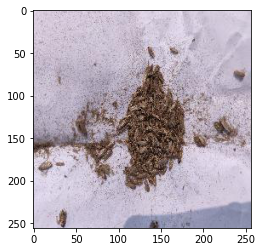

In [22]:
# Test the image batching process, and make sure that the y_col labels being passed are accurate i.e. 10% OOD approximately (OOD coded as 0s)
a,b = next(traingen);print("img_batch_shape",a.shape);print("label_vec.shape",b.shape);print(b.reshape(-1));plt.imshow(a[0]);print("label_vec.mean",b.mean())

## Build CNN Network Architecture Using Keras TensorFlow and EncoderBlocks from the CAE

In [26]:
from models.autoencoder import EncodeBlock
from cnn_model import plot_learning_curve, wt_BCE_loss_debug_test, wt_BCE_loss

In [79]:
### CNN Model Parameters ###
encoder_blocks = 6 # The number of overall encoder blocks to include, each encoder block contains a (Conv2D + BatchNorm + Activation) + (Conv2D + BatchNorm + Activation) + MaxPool set of layers
use_batch_norm=True # Designate if the encoder should use batch norm following the Conv2D layer
activation = ReLU # Set the activation function for the Conv2D layers
kernel_size=3 # Set the window size for the Conv2D kernels
kernel_regularizer=None # Set regularization if desired for the kernel weights
kernel_initializer='he_normal' # Set how the kernel weights are to be randomly initialized
init_filters=32 # Initial filter count for the first layer
filter_mult=2 # The reduction factor of the filters
filter_mult_every=2 # How often that reduction factor is applied
encode_filters = [int(init_filters * filter_mult**np.floor(block_num / filter_mult_every)) for block_num in range(encoder_blocks)] # Generate the # of filters for each encoder block

use_weighted_loss = True # Toggle to specify if a weighted binary-cross entropy loss function should be used when training

In [81]:
# Construct the auto-encoder model using the Tensorflow function API framework
CNN_model = models.Sequential(name='CNN_model') # Define a sequential model i.e. a Neural Network
CNN_model.add(Input(shape=IMAGE_SHAPE)) # Define the input layer for the encoder model

# Add encoder convolution blocks to the network in the number specified by encoder_blocks
for block_num in range(encoder_blocks):
    CNN_model.add(EncodeBlock(
                      name=f'encode_{block_num}', 
                      filters=encode_filters[block_num], 
                      kernel_size=kernel_size,
                      activation=activation,
                      batch_norm=use_batch_norm,
                      kernel_regularizer=kernel_regularizer,
                      kernel_initializer=kernel_initializer)
                      )

# FCNN Classification Prediction Layers - FCNN Model
CNN_model.add(Flatten()) # Flatten and feed to a fully connected neural network (FCNN)

CNN_model.add(Dense(128, activation="relu"))
CNN_model.add(Dropout(0.2)) 

CNN_model.add(Dense(128, activation="relu"))
CNN_model.add(Dropout(0.2))

CNN_model.add(Dense(1, activation="sigmoid")) # Final sigmoid activation layer for generating a binary prediction, output layer

CNN_model.build((None, *IMAGE_SHAPE)) # Construct the model

if use_weighted_loss:
  class_weights = img_data_df.loc[:,"label"].mean(0) # Compute the % of 1s in the label column
  w_0 = class_weights # Weight put on zero labels for each class = N_1/N_total, we give the % of 1s in the data set as the weight of the 0s in the loss
  w_1 = 1-w_0 # Weight put on 1 labels for each class = N_0/N_total, we give the % of 0s in the data set as the weight of the 1s in the loss
  assert (w_1+w_0) == 1, "w_0 + W_1 not summing to 1" # Data Validation
  # Convert loss weightings to tensor for use in keras
  w_1 = tf.convert_to_tensor(w_1,dtype=float)
  w_0 = tf.convert_to_tensor(w_0,dtype=float)

  # Compile the model using the weighted binary cross entropy loss function
  CNN_model.compile(loss=wt_BCE_loss, optimizer='adam', metrics=['accuracy']) # Compile the model so that it can be trained
else:
  CNN_model.compile(loss="binary_crossentropy", optimizer='adam', metrics=['accuracy']) # Compile the model so that it can be trained

CNN_model.summary();print("Loss Function:",CNN_model.loss) # Print the model summary to visualize the layers and parameters

Model: "CNN_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encode_0 (EncodeBlock)      (None, 128, 128, 32)      10400     
                                                                 
 encode_1 (EncodeBlock)      (None, 64, 64, 32)        18752     
                                                                 
 encode_2 (EncodeBlock)      (None, 32, 32, 64)        55936     
                                                                 
 encode_3 (EncodeBlock)      (None, 16, 16, 64)        74368     
                                                                 
 encode_4 (EncodeBlock)      (None, 8, 8, 128)         222464    
                                                                 
 encode_5 (EncodeBlock)      (None, 4, 4, 128)         296192    
                                                                 
 flatten_3 (Flatten)         (None, 2048)              0 

## CNN Model Fitting

##### Training Pass 1

In [ ]:
### Model training parameters ###
epochs = 50 # Total number of full training data set iterations
patience = 10 # Number of epochs for early stopping
savefigs = True # Toggle to save the figures produced by the training history
verbose = 1 # Toggle for amount of screen updates to be printed during training

if dataset == 'bollworms':
  model_weights_save_name = "logs/cnn_model_weights/CNN_model_weights_bollworms_train.h5"
else:
  model_weights_save_name = "logs/cnn_model_weights/CNN_model_weights_bollworms_clean_train.h5"

# Helper routine for printing messages to the console during training
print_banner = lambda msg, char, num=30: print('\n' + char*num + f' {msg} ' + char*num + '\n')
if verbose: print_banner('TRAINING CNN MODEL END-TO-END', '=', 19)
  
# Train model and save weights
es = EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
hist = CNN_model.fit(traingen, validation_data=valgen, epochs=epochs, callbacks=[es], verbose=verbose)
CNN_model.save_weights(model_weights_save_name) # Save the trained weights to drive


=================== TRAINING CNN MODEL END-TO-END ===================

Epoch 1/50
219/219 [==============================] - 7158s 33s/step - loss: 0.0758 - accuracy: 0.8699 - val_loss: 0.0771 - val_accuracy: 0.8806
Epoch 2/50
219/219 [==============================] - 23s 105ms/step - loss: 0.0636 - accuracy: 0.8961 - val_loss: 0.0548 - val_accuracy: 0.8794
Epoch 3/50
219/219 [==============================] - 23s 105ms/step - loss: 0.0592 - accuracy: 0.9085 - val_loss: 0.0516 - val_accuracy: 0.8960
Epoch 4/50
219/219 [==============================] - 23s 104ms/step - loss: 0.0537 - accuracy: 0.9108 - val_loss: 0.0605 - val_accuracy: 0.9446
Epoch 5/50
219/219 [==============================] - 24s 108ms/step - loss: 0.0619 - accuracy: 0.9052 - val_loss: 0.0529 - val_accuracy: 0.8771
Epoch 6/50
219/219 [==============================] - 24s 109ms/step - loss: 0.0553 - accuracy: 0.9046 - val_loss: 0.0667 - val_accuracy: 0.8269
Epoch 7/50
219/219 [==============================] - 24s 

##### Training Pass 2

In [ ]:
### Model training parameters ###
epochs = 50 # Total number of full training data set iterations
patience = 10 # Number of epochs for early stopping
savefigs = True # Toggle to save the figures produced by the training history
verbose = 1 # Toggle for amount of screen updates to be printed during training

if dataset == 'bollworms':
  model_weights_save_name = "logs/cnn_model_weights/CNN_model_weights_bollworms_train.h5"
else:
  model_weights_save_name = "logs/cnn_model_weights/CNN_model_weights_bollworms_clean_train.h5"

# Helper routine for printing messages to the console during training
print_banner = lambda msg, char, num=30: print('\n' + char*num + f' {msg} ' + char*num + '\n')
if verbose: print_banner('TRAINING CNN MODEL END-TO-END', '=', 19)
  
# Train model and save weights
es = EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
hist = CNN_model.fit(traingen, validation_data=valgen, epochs=epochs, callbacks=[es], verbose=verbose)
CNN_model.save_weights(model_weights_save_name) # Save the trained weights to drive


=================== TRAINING CNN MODEL END-TO-END ===================

Epoch 1/50
219/219 [==============================] - 23s 103ms/step - loss: 0.0491 - accuracy: 0.9156 - val_loss: 0.1435 - val_accuracy: 0.5920
Epoch 2/50
219/219 [==============================] - 22s 102ms/step - loss: 0.0532 - accuracy: 0.9072 - val_loss: 0.1033 - val_accuracy: 0.4869
Epoch 3/50
219/219 [==============================] - 23s 103ms/step - loss: 0.0471 - accuracy: 0.9278 - val_loss: 0.0521 - val_accuracy: 0.9029
Epoch 4/50
219/219 [==============================] - 23s 103ms/step - loss: 0.0495 - accuracy: 0.9189 - val_loss: 0.0448 - val_accuracy: 0.9217
Epoch 5/50
219/219 [==============================] - 23s 104ms/step - loss: 0.0425 - accuracy: 0.9239 - val_loss: 0.0437 - val_accuracy: 0.9394
Epoch 6/50
219/219 [==============================] - 23s 103ms/step - loss: 0.0473 - accuracy: 0.9116 - val_loss: 0.0546 - val_accuracy: 0.8600
Epoch 7/50
219/219 [==============================] - 23s 

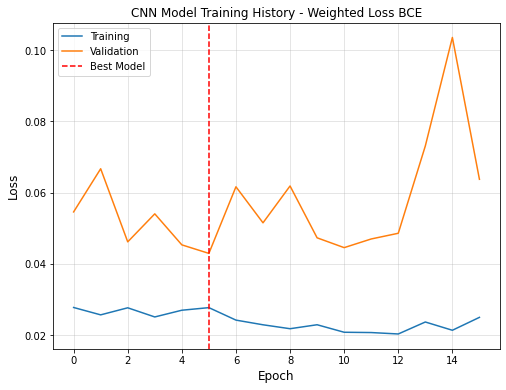

In [ ]:
# Plot learning curve from training
titles = {'mean_squared_error': 'Mean Squared Error', 'mean_absolute_error': 'Mean Absolute Error'}
saveas = 'Eric/CNN_model/CNN_model_training_loss.png' if savefigs else None
plot_title = "CNN Model Training History - Weighted Loss BCE" if use_weighted_loss else "CNN Model Training History - Unweighted BCE"
plot_learning_curve(hist, es, title=plot_title, saveas=None)

#### Load Trained Weights


---

Weights that have already been trained can be loaded from disk using the following

In [ ]:
if dataset == 'bollworms':
  CNN_model.load_weights("logs/cnn_model_weights/CNN_model_weights_bollworms_train.h5") # Load pre-trained weights for the CNN trained on bollworms-train (EC in ID)
else:
  CNN_model.load_weights("logs/cnn_model_weights/CNN_model_weights_bollworms_clean_train.h5") # Load pre-trained weights for the CNN trained on bollworms-clean-train (EC in OOD)

## CNN Model Evaluation

#### Import Helper Functions

In [ ]:
from cnn_model import predict_on_test, plot_confusion_matrix, generate_roc_summary
from sklearn.metrics import roc_auc_score, roc_curve, f1_score

#### Trained Model Evaluation

In [ ]:
# Generate train and validation set predictions on the images in traingen and valgen for analysis
train_set_preds, train_set_y_true = predict_on_test(CNN_model, traingen, write_to_csv=False)
val_set_preds, val_set_y_true = predict_on_test(CNN_model, valgen, write_to_csv=False)

Generating test set predictions...


100%|██████████| 219/219 [00:21<00:00, 10.19it/s]


Generating test set predictions...


100%|██████████| 55/55 [00:05<00:00, 10.39it/s]


In [ ]:
train_set_preds = train_set_preds.values;train_set_y_true = train_set_y_true.values # Convert to numpy arrays
val_set_preds = val_set_preds.values;val_set_y_true = val_set_y_true.values # Convert to numpy arrays
train_set_preds_bin = (train_set_preds>0.5)*1 # Convert to a binary label 0/1 for the predicted values
val_set_preds_bin = (val_set_preds>0.5)*1 # Convert to a binary label 0/1 for the predicted values
assert train_set_preds_bin.shape == train_set_preds.shape # Data validation on shapes
assert val_set_preds_bin.shape == val_set_preds.shape # Data validation on shapes

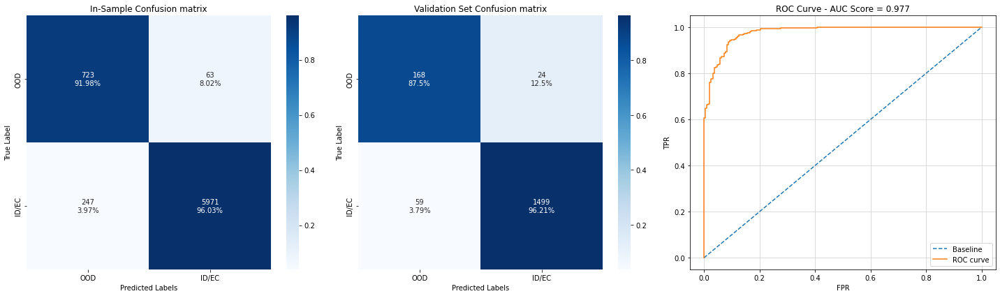

In [ ]:
fig,axes = plt.subplots(1,3,figsize=(20,6)) # Plot the confusion matrix summary for the in-sample and out of sample validation results
plot_confusion_matrix(train_set_y_true, train_set_preds_bin, title='In-Sample Confusion matrix', label_text={1:"ID/EC",0:"OOD"},ax=axes[0])
plot_confusion_matrix(val_set_y_true, val_set_preds_bin, title='Validation Set Confusion matrix', label_text={1:"ID/EC",0:"OOD"},ax=axes[1])
generate_roc_summary(val_set_y_true, val_set_preds,ax=axes[2]);plt.tight_layout();plt.show()

#### Test Set Analysis

In [ ]:
if dataset == 'bollworms':
  DATA_DIR = 'bollworms-test/' # The directory that holds all the images to be used for training and validation, make sure it ends with /
else:
  DATA_DIR = 'bollworms-clean-test/' # The directory that holds all the images to be used for training and validation, make sure it ends with /

id_data_folder = DATA_DIR+'ID'
id_image_files = glob.glob(f'{id_data_folder}/*.jpg')

ood_data_folder = DATA_DIR+'OOD'
ood_image_files = glob.glob(f'{ood_data_folder}/*.jpg')

print(f'Found {len(id_image_files)} ID images.')
print(f'Found {len(ood_image_files)} OOD images.')
print(f'Found {len(id_image_files)+len(ood_image_files)} total images.')

Found 865 ID images.
Found 108 OOD images.
Found 973 total images.


In [ ]:
img_data_df = pd.DataFrame({"img_name":id_image_files+ood_image_files,
                            "label":np.concatenate([np.ones(len(id_image_files)),np.zeros(len(ood_image_files))])})

img_data_df.loc[:,"img_name"] = img_data_df.loc[:,"img_name"].str.replace(DATA_DIR,"") # Remove the leading DATA_DIR in the image file names e.g. data_256px_2022-10-03/ID/6cb26765065f0ccaf96c2178.jpg
print("img_data_df.shape",img_data_df.shape)

img_data_df.shape (973, 2)


In [ ]:
IMAGE_SHAPE = (256, 256, 3) # Input image shapes
BATCH_SIZE = 128 # Number of images per batch for each call of next to the data loader

# Set up a TensorFlow data generator, scale int values from 0-255 to 0-1 and set aside some of the examples for validation
datagen = ImageDataGenerator(rescale=1./255,validation_split=0)

# Create a training set data generator for fitting the model and a validation set data generator for evaluation
testgen = datagen.flow_from_dataframe(
    img_data_df, 
    directory=DATA_DIR,
    x_col='img_name',
    y_col='label',
    target_size=IMAGE_SHAPE[:-1],
    batch_size=BATCH_SIZE,
    class_mode='raw',
    subset='training',
    shuffle=False,
    seed=None,
    save_to_dir=None,
    save_format='JPG',
    color_mode='rgb')

Found 973 validated image filenames.


In [ ]:
test_set_preds, test_set_y_true = predict_on_test(CNN_model, testgen, write_to_csv=False)

Generating test set predictions...


100%|██████████| 8/8 [01:44<00:00, 13.06s/it]


In [ ]:
test_set_preds = test_set_preds.values;test_set_y_true = test_set_y_true.values # Convert to numpy arrays
test_set_preds_bin = (test_set_preds>0.5)*1 # Convert to a binary label 0/1 for the predicted values
assert test_set_preds_bin.shape == test_set_preds.shape # Data validation, check data shapes

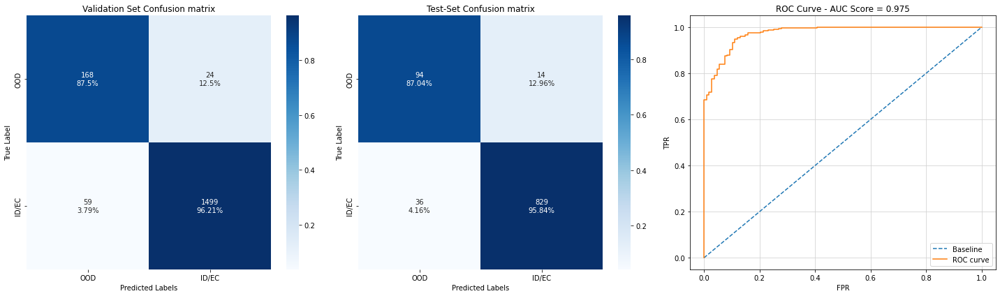

In [ ]:
fig,axes = plt.subplots(1,3,figsize=(20,6)) # Plot the confusion matrix summary for the in-sample and out of sample validation results
plot_confusion_matrix(val_set_y_true, val_set_preds_bin, title='Validation Set Confusion matrix', label_text={1:"ID/EC",0:"OOD"},ax=axes[0])
plot_confusion_matrix(test_set_y_true, test_set_preds_bin, title='Test-Set Confusion matrix', label_text={1:"ID/EC",0:"OOD"},ax=axes[1])
generate_roc_summary(test_set_y_true, test_set_preds,ax=axes[2]);plt.tight_layout();plt.show()

In [ ]:
print("Test set AUC:",round(roc_auc_score(test_set_y_true, test_set_preds),2))
print("Test set F1 score:",round(f1_score(test_set_y_true, test_set_preds_bin, average='macro'),2))

Test set AUC: 0.97
Test set F1 score: 0.88


## CNN Model Evaluation on External OOD Data Sets

In [44]:
from data_utils.datasets import find_image_files, build_dataset # Import functionalities from other modules

#### Build External OOD Data Sets

Found 20580 image files in folder "data/stanford_dogs/Images/*"


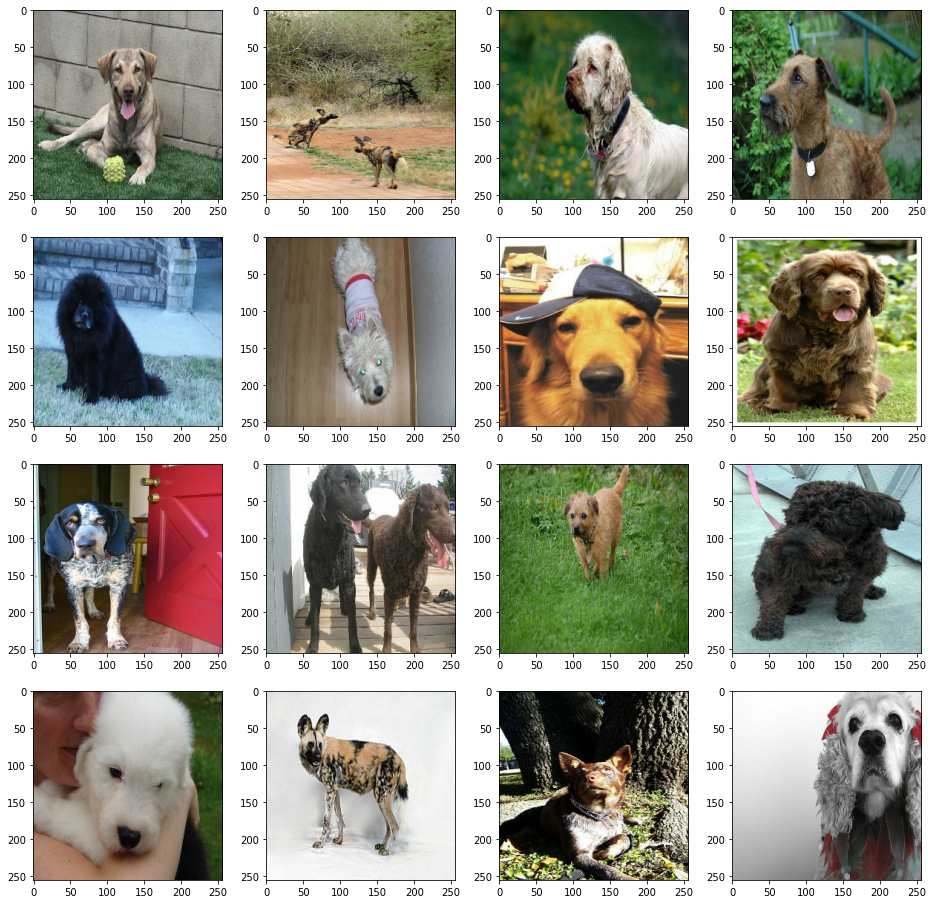

In [ ]:
stanford_dogs_df = find_image_files('data/stanford_dogs/Images/*')
stanford_dogs_df = stanford_dogs_df.sample(frac=1, random_state=297) # Shuffle the data frame to get dogs of all types from top to bottom
ds_kwargs = {'cache': True, 'image_shape': (256, 256, 3), 'batch_size': 32, 'shuffle_buffer': 512} # These keyword arguments will be shared by all image datasets
stanford_dogs_ds = build_dataset(stanford_dogs_df.iloc[:3000,:], augment=False, shuffle=False, **ds_kwargs) # Use the first 3000 as a test

# Display sample images from stanford_dogs dataset
fig, axes = plt.subplots(4, 4, figsize=(16, 16))
for (input_images, target_images) in stanford_dogs_ds.take(1):
    for ax, image in zip(axes.flatten(), input_images[:16]):
        ax.imshow(image)

Found 1620 image files in folder "data/flowers102/*"


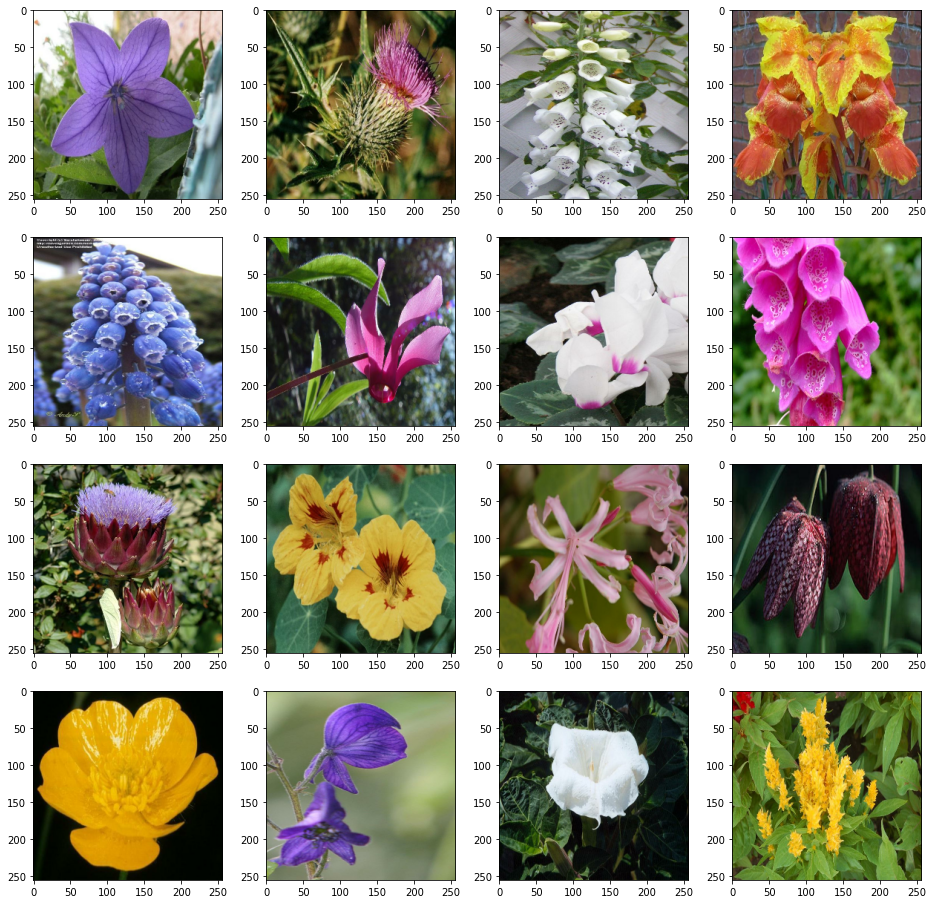

In [45]:
flowers102_df = find_image_files('data/flowers102/*')
flowers102_df = flowers102_df.sample(frac=1, random_state=297) # Shuffle the data frame to get flowers of all types from top to bottom
ds_kwargs = {'cache': True, 'image_shape': (256, 256, 3), 'batch_size': 32, 'shuffle_buffer': 512} # These keyword arguments will be shared by all image datasets
flowers102_ds = build_dataset(flowers102_df.iloc[:3000,:], augment=False, shuffle=False, **ds_kwargs) # Use the first 3000 as a test

# Display sample images from stanford_dogs dataset
fig, axes = plt.subplots(4, 4, figsize=(16, 16))
for (input_images, target_images) in flowers102_ds.take(1):
    for ax, image in zip(axes.flatten(), input_images[:16]):
        ax.imshow(image)

#### Generate test predictions using the CNN model

In [ ]:
stanford_dogs_pred = [] # Create a list to hold the predicted values from the CNN model
for (input_images, target_images) in tqdm(stanford_dogs_ds):
  stanford_dogs_pred.append(CNN_model(input_images)) # Iterate over the entire external OOD dataset and append the predictions as we go

100%|██████████| 94/94 [03:34<00:00,  2.28s/it]


In [ ]:
stanford_dogs_pred_agg = np.concatenate(stanford_dogs_pred) # Combine into 1 array

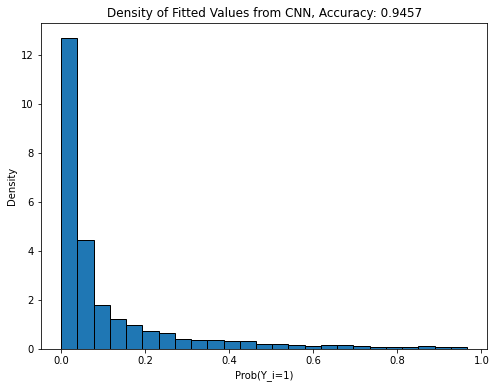

In [ ]:
plt.figure(figsize=(8,6));plt.title("Density of Fitted Values from CNN, Accuracy: "+str(round(((stanford_dogs_pred_agg<0.5)*1).mean(),4)))
plt.ylabel("Density");plt.xlabel("Prob(Y_i=1)");plt.hist(stanford_dogs_pred_agg,edgecolor='black',bins=25,density=True);plt.show()

In [ ]:
flowers102_pred = [] # Create a list to hold the predicted values from the CNN model
for (input_images, target_images) in tqdm(flowers102_ds):
  flowers102_pred.append(CNN_model(input_images)) # Iterate over the entire external OOD dataset and append the predictions as we go

100%|██████████| 94/94 [00:26<00:00,  3.57it/s]


In [ ]:
flowers102_pred_agg = np.concatenate(flowers102_pred) # Combine into 1 array

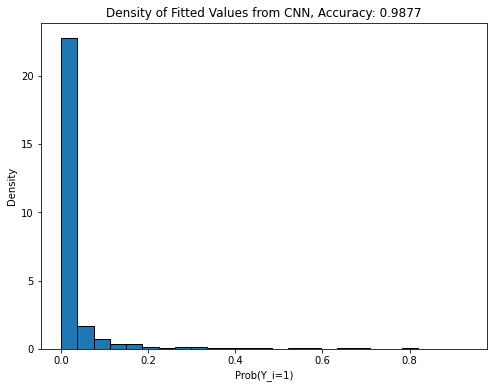

In [ ]:
plt.figure(figsize=(8,6));plt.title("Density of Fitted Values from CNN, Accuracy: "+str(round(((flowers102_pred_agg<0.5)*1).mean(),4)))
plt.ylabel("Density");plt.xlabel("Prob(Y_i=1)");plt.hist(flowers102_pred_agg,edgecolor='black',bins=25,density=True);plt.show()

## Saliency Mapping for Network Feature Focus Interpretability

#### Saliency Maps

A few helpful references:

https://www.kaggle.com/code/devangvinci/basic-cnn-gradcam-saliency-map

https://keisen.github.io/tf-keras-vis-docs/api/tf_keras_vis.utils.scores.html



In [50]:
!pip install tf_keras_vis # Install the required library

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 52 kB 845 kB/s 


In [54]:
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils import normalize
from tf_keras_vis.utils.scores import CategoricalScore, BinaryScore

In [ ]:
from cnn_model import predict_on_test_with_filenames, SaliencyMapGen, GradCAM

In [52]:
# Generate the input data needed to make saliency maps, get a batch from val_batch_imgs, compute the predicted y_hat in [0,1] values for each image
# with 1 encoding ID and 0 encoding OOD, aggregate the true image labels into a vector, aggregate the filenames into a vector, aggregate the batch
# input images into an array. The 3rd argument of "1" specifies how many batches to iterate through when generating these aggregate data structures
val_preds, y_true_val, filenames, val_batch_imgs = predict_on_test_with_filenames(CNN_model, valgen, 1)

Generating model set predictions...


100%|██████████| 1/1 [00:22<00:00, 22.34s/it]


In [55]:
thresholded_preds = (val_preds.numpy() > 0.5).astype(int).reshape(-1) # Convery model output predicted probs to 0/1 hard classificatons and int types
saliency_map_CNN2 = SaliencyMapGen(CNN_model) # Create the saliency map generator for CNN_model2

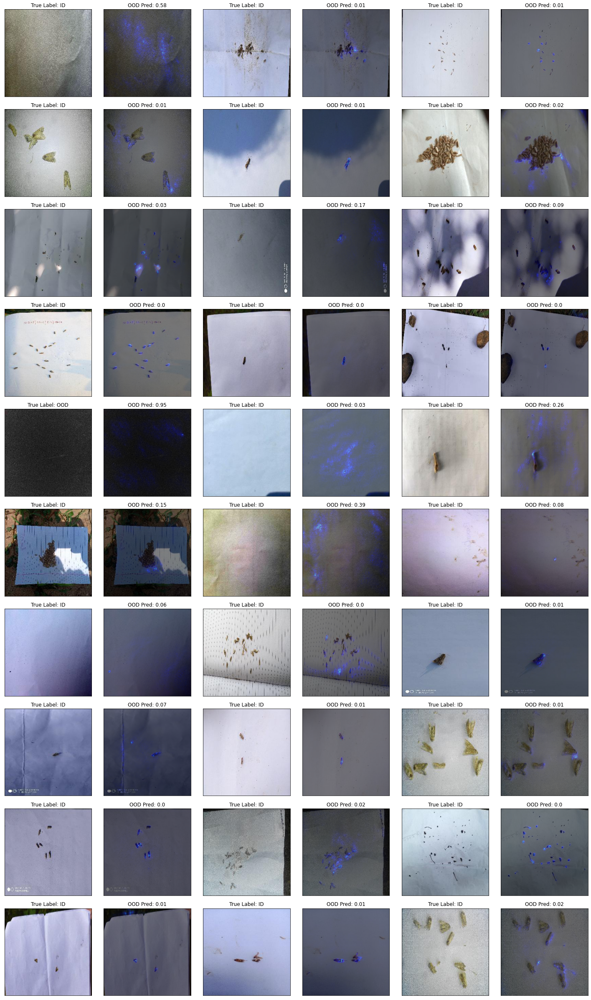

In [56]:
### Hyper-Parameters ###
alpha=0.5 # Controls the blend of the original image and the heatmap, alpha is [0,1] and a higher value of alpha gives more weight to the original image (less heatmap)
### Hyper-Parameters ###
# https://keisen.github.io/tf-keras-vis-docs/examples/attentions.html

rows = 10; cols = 6 # Specify the plot dimensions for the saliency maps
fig,axes = plt.subplots(rows,cols,figsize=(20/6*cols,20/6*rows));axes=axes.reshape(-1)

for j in range(len(axes)//2):
  input_image = val_batch_imgs[j,:,:,:] # The input image we want to use for the saliency map
  axes[j*2].imshow(input_image) # Display the original image + the image + heatmap overleaf  
  saliency_map_CNN2.plot_saliency_map(input_image,thresholded_preds[j],ax=axes[j*2+1],smooth_grad=False) 
  axes[j*2].set_xticks([]);axes[j*2].set_yticks([]) # Remove the x axis ticks
  axes[j*2+1].set_xticks([]);axes[j*2+1].set_yticks([]) # Remove the y axis ticks
  
  if y_true_val[j].numpy()==1:
    part1 = "True Label: "+"ID"
  else:
    part1 = "True Label: "+"OOD"
  part2 = "OOD Pred: "+str(round(1-val_preds[j].numpy()[0],2))
  axes[j*2].set_title(part1)
  axes[j*2+1].set_title(part2)

plt.tight_layout();plt.show()

In [57]:
val_preds, y_true_val, filenames, val_batch_imgs = predict_on_test_with_filenames(CNN_model, valgen, 1)

Generating model set predictions...


100%|██████████| 1/1 [00:14<00:00, 14.77s/it]


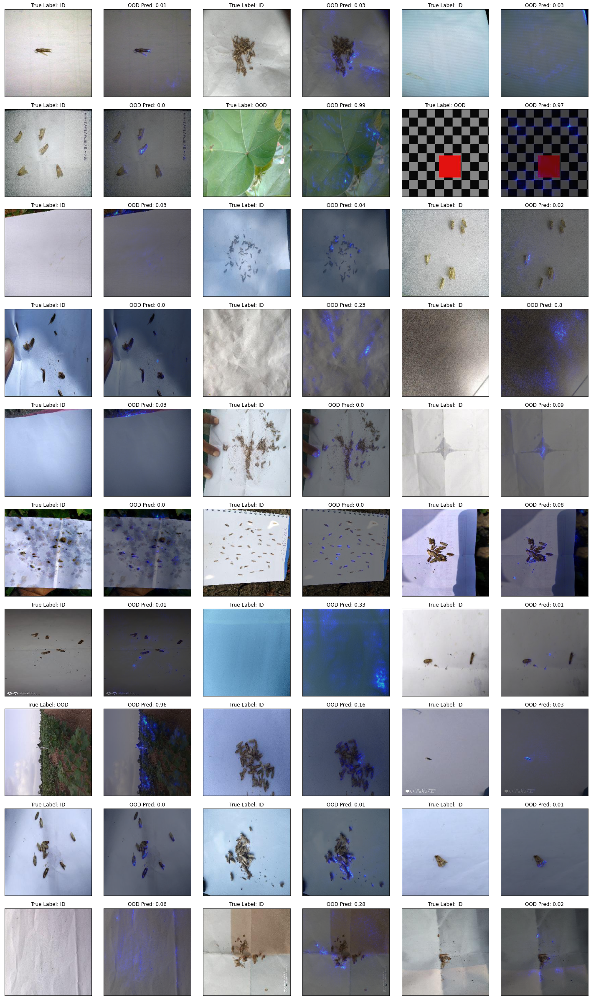

In [58]:
### Hyper-Parameters ###
alpha=0.5 # Controls the blend of the original image and the heatmap, alpha is [0,1] and a higher value of alpha gives more weight to the original image (less heatmap)
### Hyper-Parameters ###
# https://keisen.github.io/tf-keras-vis-docs/examples/attentions.html

rows = 10; cols = 6 # Specify the plot dimensions for the saliency maps
fig,axes = plt.subplots(rows,cols,figsize=(20/6*cols,20/6*rows));axes=axes.reshape(-1)

for j in range(len(axes)//2):
  input_image = val_batch_imgs[j,:,:,:] # The input image we want to use for the saliency map
  axes[j*2].imshow(input_image) # Display the original image + the image + heatmap overleaf  
  saliency_map_CNN2.plot_saliency_map(input_image,thresholded_preds[j],ax=axes[j*2+1],smooth_grad=False) 
  axes[j*2].set_xticks([]);axes[j*2].set_yticks([]) # Remove the x axis ticks
  axes[j*2+1].set_xticks([]);axes[j*2+1].set_yticks([]) # Remove the y axis ticks
  
  if y_true_val[j].numpy()==1:
    part1 = "True Label: "+"ID"
  else:
    part1 = "True Label: "+"OOD"
  part2 = "OOD Pred: "+str(round(1-val_preds[j].numpy()[0],2))
  axes[j*2].set_title(part1)
  axes[j*2+1].set_title(part2)

plt.tight_layout();plt.show()

#### Mis-Classified OOD Images

In [103]:
# Let's look specifically at mis-classified OOD images
val_preds_full, y_true_val_full, filenames_full, val_batch_imgs_full = predict_on_test_with_filenames(CNN_model, valgen, 30)

Generating model set predictions...


100%|██████████| 30/30 [00:03<00:00,  8.69it/s]


In [104]:
OOD_mis_class_idx = (((val_preds_full.numpy().reshape(-1)>0.5)*1)==1)&(y_true_val_full==0) # Predicted a label of 1 (ID) when the true label was 0 (OOD)

In [105]:
OOD_mis_class_idx = (((val_preds_full.numpy().reshape(-1)>0.5)*1)==1)&(y_true_val_full==0) # Predicted a label of 1 (ID) when the true label was 0 (OOD)
OOD_mis_class_idx = OOD_mis_class_idx.numpy();print("OOD mis-class images:",sum(OOD_mis_class_idx))

# Segment out just the OOD miss-class images
val_preds, y_true_val, filenames, val_batch_imgs = val_preds_full.numpy()[OOD_mis_class_idx,0], y_true_val_full.numpy()[OOD_mis_class_idx],\
filenames_full[OOD_mis_class_idx], val_batch_imgs_full[OOD_mis_class_idx,:,:,:]

OOD mis-class images: 9


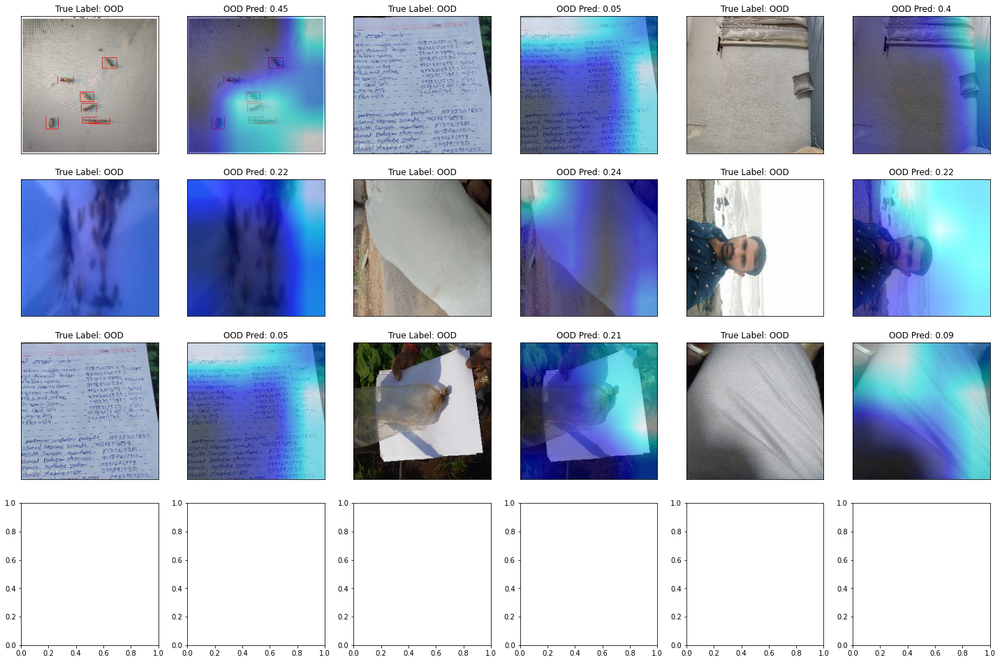

In [106]:
# Let's look specifically at mis-classified OOD images

### Hyper-Parameters ###
class_label = 0 # Select which class label to generate saliency wrt i.e. 1 for ID/EC and 0 for OOD predictions from the network
block_name = 'encode_5' # Designate which layers to compte gradients on 
alpha = 0.5 # Controls the blend of the original image and the heatmap, alpha is [0,1] and a higher value of alpha gives more weight to the original image (less heatmap)
### Hyper-Parameters ###

cols = 6; rows = max(1,(sum(OOD_mis_class_idx)*2)//6+1)
fig,axes = plt.subplots(rows,cols,figsize=(20/6*cols,20/6*rows));axes=axes.reshape(-1)

for j in range(sum(OOD_mis_class_idx)):
  image = val_batch_imgs[j:(j+1),:,:,:] # The input image we want to use grad-cam for
  icam = GradCAM(CNN_model, class_label, block_name)  # Set i to be the output label of the image
  heatmap = icam.compute_heatmap(image)
  (heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_HOT)
  axes[j*2].imshow(image[0,:,:,:]);axes[j*2+1].imshow(output) # Display the original image + the image + heatmap overleaf
  axes[j*2].set_xticks([]);axes[j*2].set_yticks([]) # Remove the x axis ticks
  axes[j*2+1].set_xticks([]);axes[j*2+1].set_yticks([]) # Remove the y axis ticks

  if y_true_val[j]==1:
    part1 = "True Label: "+"ID"
  else:
    part1 = "True Label: "+"OOD"
  part2 = "OOD Pred: "+str(round(1-val_preds[j],2))
  axes[j*2].set_title(part1)
  axes[j*2+1].set_title(part2)

plt.tight_layout();plt.show()

#### Mis-Classified ID Images

In [116]:
ID_mis_class_idx = (((val_preds_full.numpy().reshape(-1)>0.5)*1)==0)&(y_true_val_full.numpy()==1) # Predicted a label of 1 (ID) when the true label was 0 (OOD)ID_mis_class_idx = ID_mis_class_idx.numpy();print("ID mis-class images:",sum(ID_mis_class_idx))

# Segment out just the ID miss-class images
val_preds, y_true_val, filenames, val_batch_imgs = val_preds_full.numpy()[ID_mis_class_idx,0], y_true_val_full.numpy()[ID_mis_class_idx],\
filenames_full[ID_mis_class_idx], val_batch_imgs_full[ID_mis_class_idx,:,:,:]

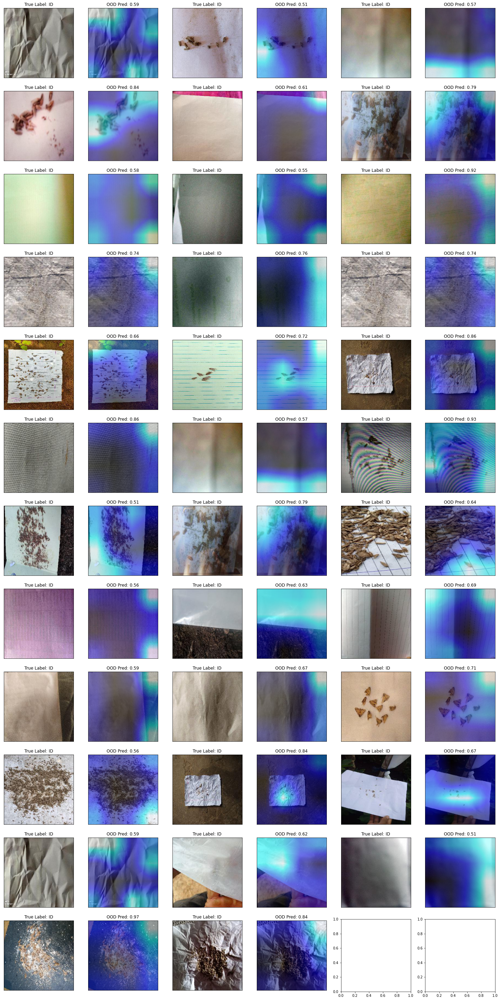

In [117]:
# Let's look specifically at mis-classified ID images

### Hyper-Parameters ###
class_label = 0 # Select which class label to generate saliency wrt i.e. 1 for ID/EC and 0 for OOD predictions from the network
block_name = 'encode_5' # Designate which layers to compte gradients on 
alpha = 0.5 # Controls the blend of the original image and the heatmap, alpha is [0,1] and a higher value of alpha gives more weight to the original image (less heatmap)
### Hyper-Parameters ###

cols = 6; rows = max(0,(sum(ID_mis_class_idx)*2)//6+1)
fig,axes = plt.subplots(rows,cols,figsize=(20/6*cols,20/6*rows));axes=axes.reshape(-1)

for j in range(sum(ID_mis_class_idx)):
  image = val_batch_imgs[j:(j+1),:,:,:] # The input image we want to use grad-cam for
  icam = GradCAM(CNN_model, class_label, block_name)  # Set i to be the output label of the image
  heatmap = icam.compute_heatmap(image)
  (heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_HOT)
  axes[j*2].imshow(image[0,:,:,:]);axes[j*2+1].imshow(output) # Display the original image + the image + heatmap overleaf
  axes[j*2].set_xticks([]);axes[j*2].set_yticks([]) # Remove the x axis ticks
  axes[j*2+1].set_xticks([]);axes[j*2+1].set_yticks([]) # Remove the y axis ticks

  if y_true_val[j]==1:
    part1 = "True Label: "+"ID"
  else:
    part1 = "True Label: "+"OOD"
  part2 = "OOD Pred: "+str(round(1-val_preds[j],2))
  axes[j*2].set_title(part1)
  axes[j*2+1].set_title(part2)

plt.tight_layout();plt.show()

#### Compute Grad-Cam Saliency Maps

In [120]:
# Generate the input data needed to make saliency maps, get a batch from val_batch_imgs, compute the predicted y_hat in [0,1] values for each image
# with 0 encoding ID and 1 encoding OOD, aggregate the true image labels into a vector, aggregate the filenames into a vector, aggregate the batch
# input images into an array. The 3rd argument of "1" specifies how many batches to iterate through when generating these aggregate data structures
val_preds, y_true_val, filenames, val_batch_imgs = predict_on_test_with_filenames(CNN_model, valgen, 1)

Generating model set predictions...


100%|██████████| 1/1 [00:00<00:00,  7.15it/s]


In [121]:
# Print out the names of the NN blocks we can run Grad-Cam for 
for idx in range(len(CNN_model.layers)): # Look at the various layers of the model
  print(CNN_model.get_layer(index = idx).name)

encode_0
encode_1
encode_2
encode_3
encode_4
encode_5
flatten_3
dense_9
dropout_6
dense_10
dropout_7
dense_11


In [122]:
# Print the shapes of the various aggregate elements generated from above
print("val_preds.shape:",val_preds.shape)
print("y_true_val.shape:",y_true_val.shape)
print("filenames.shape:",filenames.shape)
print("val_batch_imgs.shape:",val_batch_imgs.shape)

val_preds.shape: (32, 1)
y_true_val.shape: (32,)
filenames.shape: (32,)
val_batch_imgs.shape: (32, 256, 256, 3)


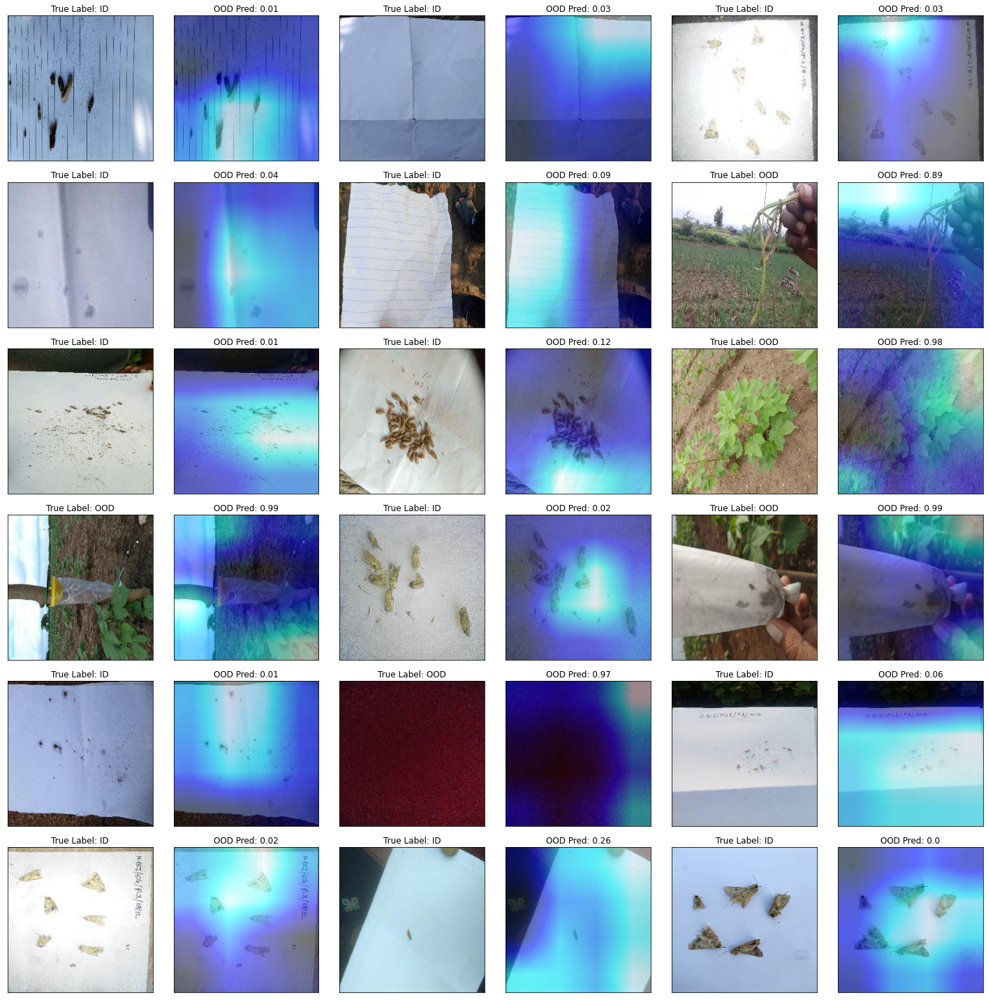

In [124]:
### Hyper-Parameters ###
class_label = 0 # Select which class label to generate saliency wrt i.e. 1 for ID/EC and 0 for OOD predictions from the network
block_name = 'encode_5' # Designate which layers to compte gradients on 
alpha=0.5 # Controls the blend of the original image and the heatmap, alpha is [0,1] and a higher value of alpha gives more weight to the original image (less heatmap)
### Hyper-Parameters ###

fig,axes = plt.subplots(6,6,figsize=(20,20));axes=axes.reshape(-1)

for j in range(len(axes)//2):
  image = val_batch_imgs[j:(j+1),:,:,:] # The input image we want to use grad-cam for
  icam = GradCAM(CNN_model, class_label, block_name)  # Set i to be the output label of the image
  heatmap = icam.compute_heatmap(image)
  (heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_HOT)
  axes[j*2].imshow(image[0,:,:,:]);axes[j*2+1].imshow(output) # Display the original image + the image + heatmap overleaf
  axes[j*2].set_xticks([]);axes[j*2].set_yticks([]) # Remove the x axis ticks
  axes[j*2+1].set_xticks([]);axes[j*2+1].set_yticks([]) # Remove the y axis ticks
  
  if y_true_val[j].numpy()==1:
    part1 = "True Label: "+"ID"
  else:
    part1 = "True Label: "+"OOD"
  part2 = "OOD Pred: "+str(round(1-val_preds[j].numpy()[0],2))
  axes[j*2].set_title(part1)
  axes[j*2+1].set_title(part2)

plt.tight_layout();plt.show()

Generating model set predictions...


100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


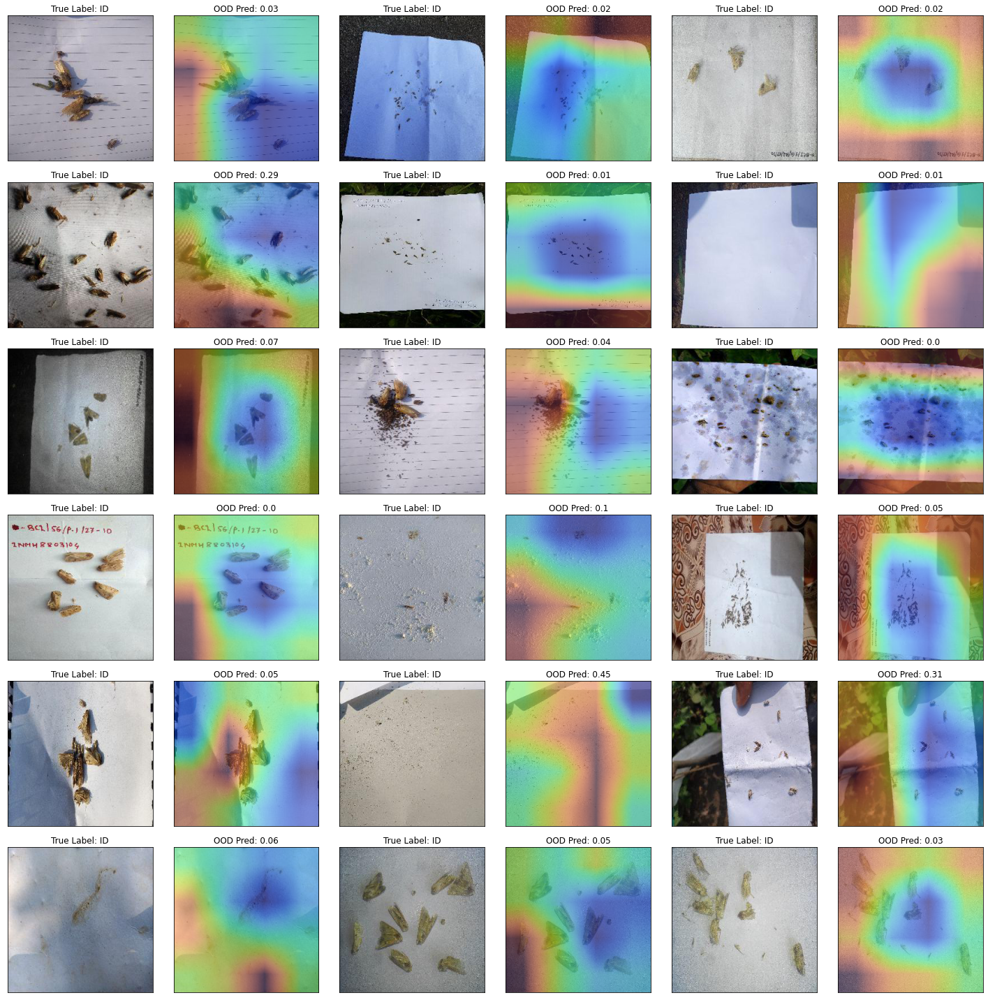

In [126]:
val_preds, y_true_val, filenames, val_batch_imgs = predict_on_test_with_filenames(CNN_model, valgen, 1)
### Hyper-Parameters ###
class_label = 0 # Select which class label to generate saliency wrt i.e. 1 for ID/EC and 0 for OOD predictions from the network
block_name = 'encode_5' # Designate which layers to compte gradients on 
alpha=0.5 # Controls the blend of the original image and the heatmap, alpha is [0,1] and a higher value of alpha gives more weight to the original image (less heatmap)
### Hyper-Parameters ###

fig,axes = plt.subplots(6,6,figsize=(20,20));axes=axes.reshape(-1)

for j in range(len(axes)//2):
  image = val_batch_imgs[j:(j+1),:,:,:] # The input image we want to use grad-cam for
  icam = GradCAM(CNN_model, class_label, block_name)  # Set i to be the output label of the image
  heatmap = icam.compute_heatmap(image)
  (heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=alpha, colormap=cv2.COLORMAP_TURBO)
  axes[j*2].imshow(image[0,:,:,:]);axes[j*2+1].imshow(output) # Display the original image + the image + heatmap overleaf
  axes[j*2].set_xticks([]);axes[j*2].set_yticks([]) # Remove the x axis ticks
  axes[j*2+1].set_xticks([]);axes[j*2+1].set_yticks([]) # Remove the y axis ticks

  if y_true_val[j].numpy()==1:
    part1 = "True Label: "+"ID"
  else:
    part1 = "True Label: "+"OOD"
  part2 = "OOD Pred: "+str(round(1-val_preds[j].numpy()[0],2))
  axes[j*2].set_title(part1)
  axes[j*2+1].set_title(part2)

plt.tight_layout();plt.show() # https://docs.opencv.org/4.x/d3/d50/group__imgproc__colormap.html